# Nyquist-Shannon Sampling Theorem
In diesem Notebook verwende ich das Lied vom Basler Wettsteinmarsch. Das Lied habe ich von Youtube (https://www.youtube.com/watch?v=cqrJ-aMKJxQ) mittels dieser Webseite: savefrom.com.co/de habe ich es dann als MP3 heruntergeladen. Ich habe mich für den Wettsteinmarsch entschieden, da ich es einer der schönsten Märsche aus Basel ist.

In [ ]:
import numpy as np
import scipy.signal as sig
import scipy.io.wavfile as wav
import matplotlib.pyplot as plt
from pydub import AudioSegment
from IPython.display import Audio, display
from pathlib import Path
import os

## Use Case: Digitalisierung Schweizer Marschmusik
Die Digitalisierung von traditionellen Schweizer Märschen wie dem *Wettstein-Marsch* ist essenziell für Archivierung, Musikproduktion und Streaming-Dienste. Damit die Musik in hoher Qualität erhalten bleibt, ist die Wahl einer geeigneten Sampling-Rate entscheidend, um Verzerrungen oder Informationsverluste zu vermeiden. Hierbei spielt das Nyquist-Shannon-Theorem eine zentrale Rolle.

## Nyquist-Rate und Nyquist-Frequenz in unserem Use Case
Die **Nyquist-Frequenz** ist die höchste Frequenz, die ohne Informationsverlust wiederhergestellt werden kann. Sie wird durch die Hälfte der Sampling-Rate definiert:


f_{Nyquist} = f{s} / 2

(Entschuldigen sie die komische Formel aber leider habe ich es nicht hinbekommen, sie wie im jupyter aussehen zu lassen, deshalb ist sie nun auch im Jupyter von Latex zu dieser ansicht gewechselt worden.)

In unserem Fall beträgt die originale Sampling-Rate **44.1 kHz**, was zu einer Nyquist-Frequenz von **22.05 kHz** führt. Das bedeutet, dass das Signal alle Frequenzen bis 22.05 kHz korrekt digitalisiert und wiedergegeben werden kann.

## Warum muss die Nyquist-Frequenz berücksichtigt werden?
- **Vermeidung von Aliasing:** Wenn die Sampling-Rate zu niedrig wäre, könnten Frequenzen über der Nyquist-Frequenz als tiefere Frequenzen interpretiert werden, was zu hörbaren Verzerrungen führt.
- **Erhaltung der Klangqualität:** Eine ausreichende Sampling-Rate stellt sicher, dass alle für das menschliche Gehör relevanten Frequenzen erhalten bleiben.
- **Effiziente Speicherung:** Eine zu hohe Sampling-Rate würde Speicherplatz verschwenden, ohne einen hörbaren Mehrwert zu bieten.

## Theoretische Berechnung der minimalen Sampling-Rate
Da das menschliche Gehör Frequenzen bis etwa **20 kHz** wahrnimmt, kann die minimale erforderliche Sampling-Rate berechnet werden:

f{s, min} = 2 * f{max} = 2 * 20kHz = 40kHz

(Entschuldigen sie die komische Formel aber leider habe ich es nicht hinbekommen, sie wie im jupyter aussehen zu lassen, deshalb ist sie nun auch im Jupyter von Latex zu dieser ansicht gewechselt worden.)

Da **44.1 kHz** diese Mindestanforderung übertrifft, ist sie eine geeignete Wahl für die Digitalisierung des Wettstein-Marschs.

## Erwartungen und Schlussfolgerungen
Die Nyquist-Frequenz von **22.05 kHz** gewährleistet eine korrekte Digitalisierung aller relevanten Frequenzen, während die Sampling-Rate von 44.1 kHz Aliasing verhindert und eine hohe Klangqualität ermöglicht. Höhere Sampling-Raten wie 48 kHz oder 96 kHz sind für professionelle Anwendungen sinnvoll, aber für normale Musikwiedergabe nicht unbedingt erforderlich.


Originale Sampling-Rate: 44100 Hz


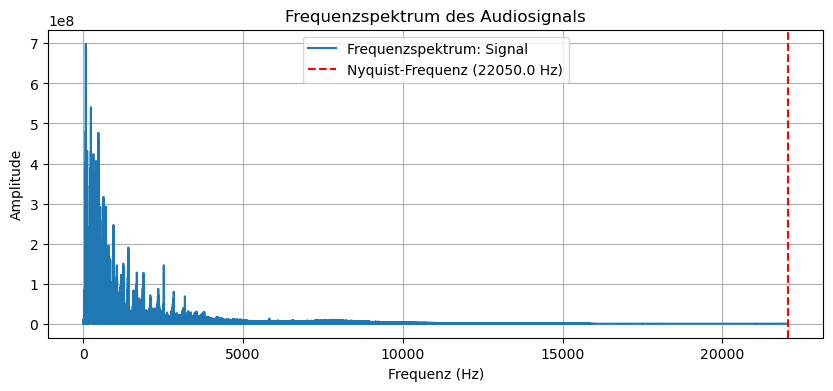

In [3]:
def convert_mp4_to_wav(mp4_path, wav_path):
    audio = AudioSegment.from_file(mp4_path, format="mp4")
    audio.export(wav_path, format="wav")

def load_audio(wav_path):
    sr, data = wav.read(wav_path)
    if data.ndim > 1:  # Falls Stereo, in Mono umwandeln
        data = data[:, 0]
    return sr, data

def plot_spectrum(signal, sr, label="Signal"):
    freqs = np.fft.rfftfreq(len(signal), d=1/sr)
    spectrum = np.abs(np.fft.rfft(signal))

    plt.figure(figsize=(10, 4))
    plt.plot(freqs, spectrum, label=f"Frequenzspektrum: {label}")
    plt.axvline(sr/2, color="r", linestyle="--", label=f"Nyquist-Frequenz ({sr/2} Hz)")
    plt.xlabel("Frequenz (Hz)")
    plt.ylabel("Amplitude")
    plt.title("Frequenzspektrum des Audiosignals")
    plt.legend()
    plt.grid()
    plt.show()

def downsample_audio(signal, sr, target_sr):
    factor = sr // target_sr
    downsampled = signal[::factor]
    return downsampled, target_sr

# Dynamischer Pfad relativ zum aktuellen Arbeitsverzeichnis
BASE_DIR = Path.cwd()  # Alternativ Path(__file__).resolve().parent, falls als Skript ausgeführt
data_dir = BASE_DIR / "Data"

mp3_path = data_dir / "Wettstein-Marsch.mp3"
wav_path = data_dir / "Wettstein-Marsch.wav"

# MP4 → WAV konvertieren
convert_mp4_to_wav(mp3_path, wav_path)

# Audio laden
sr, audio = load_audio(wav_path)
print(f"Originale Sampling-Rate: {sr} Hz")

# Frequenzspektrum anzeigen
plot_spectrum(audio, sr)

## Fazit
### Wahl der Methode
Die Methode, das Signal bei verschiedenen Abtastraten zu wiederspielen und die Frequenzspektren zu visualisieren, ist geeignet, um die Auswirkungen der Nyquist-Rate und Aliasing-Effekte anschaulich zu demonstrieren.

### Parameterwahl
Die Abtastraten ( 22,05 kHz, 10kHz und  8 kHz) wurden basierend auf typischen Audiosignalen und der Nyquist-Theorie gewählt, um die Auswirkungen von Aliasing hörbar und sichtbar zu machen.

### Interpretation
Die Ergebnisse zeigen, dass Aliasing bei Samplingraten unterhalb der Nyquist-Rate unvermeidlich ist, was zu Verzerrungen im Frequenzspektrum führt. Wird das Lied mit Samplingraten von 10 kHz oder 8 kHz abgespielt, erinnert mich das an ein altes Radio: Es rauscht, die Trommeln klingen dumpf zusätzlich wirkt das Stück aufgrund der fehlenden hohen Töne auf mich langsamer.

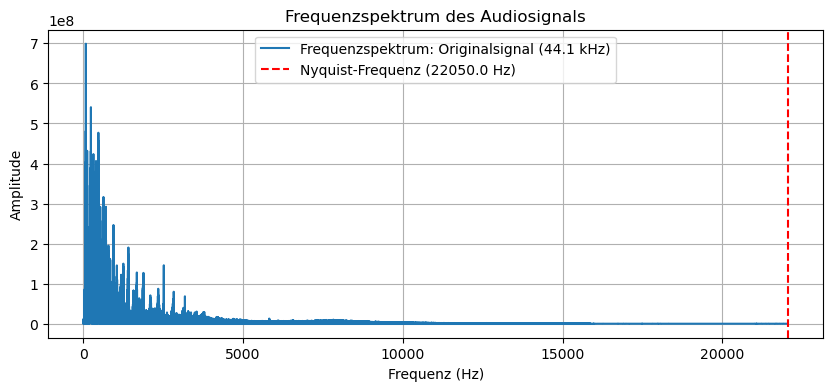

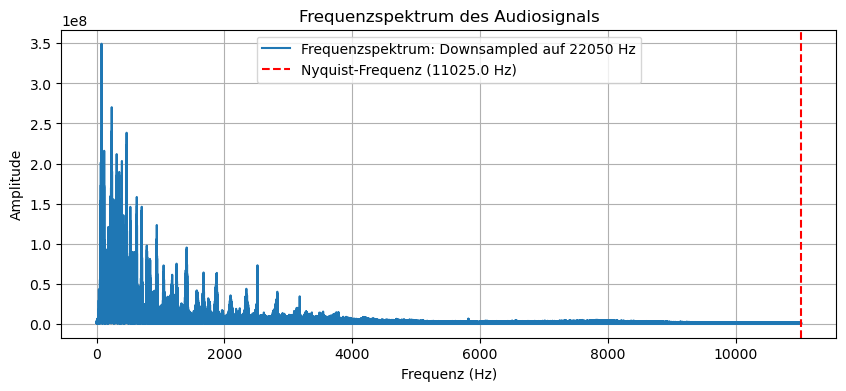

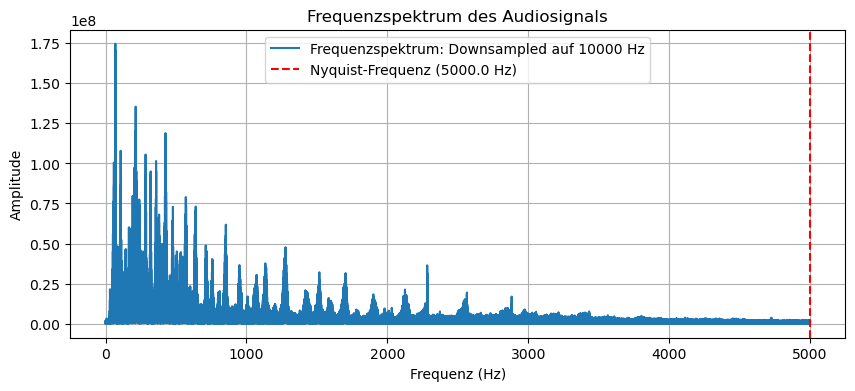

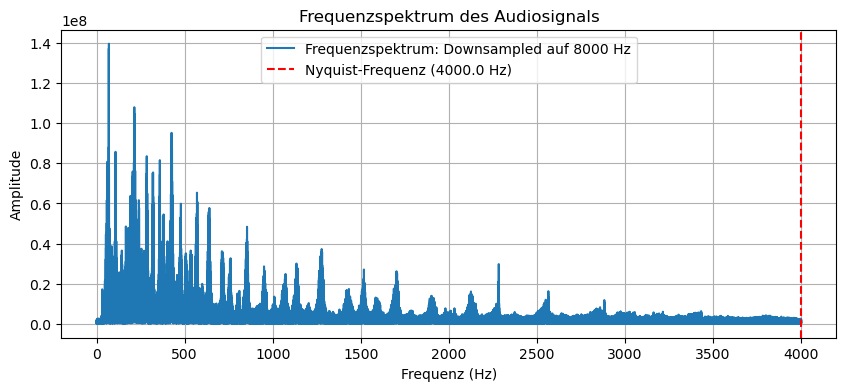

In [4]:
def play_audio(signal, sr):
    # Normalisieren, um Übersteuerung zu vermeiden
    signal = signal / np.max(np.abs(signal))
    # In 16-bit PCM umwandeln
    audio_int16 = (signal * 32767).astype(np.int16)
    display(Audio(audio_int16, rate=sr))

# Original-Frequenzspektrum (44.1 kHz)
plot_spectrum(audio, sr, "Originalsignal (44.1 kHz)")
play_audio(audio, sr)  # Original abspielen

# Downsampling auf verschiedene Sampling-Raten
for target_sr in [22050, 10000, 8000]:  # Nyquist-Rate, unterhalb Nyquist
    downsampled_audio, new_sr = downsample_audio(audio, sr, target_sr)
    plot_spectrum(downsampled_audio, new_sr, f"Downsampled auf {new_sr} Hz")
    play_audio(downsampled_audio, new_sr)  # Abgesenkte Audioqualität abspielen